# 📊 **Parte 1 — EDA y Preparación de Datos**

### 🎯 **Objetivo**
Explorar el conjunto de datos, aplicar los filtros designados y preparar los datos para la fase de modelado.

### 🔹 **Pasos Sugeridos**
1.  **Cargar el dataset original de Properati**.
2.  **Filtrar** las propiedades según los siguientes criterios:
    *   `country_name = "Argentina"`
    *   `operation_type = "Venta"`
    *   `currency = "USD"`
    *   Zonas: **CABA** y **GBA** (pueden subdividir si lo desean).
3.  **Explorar variables relevantes**:
    *   Superficie (`surface_total`, `surface_covered`)
    *   Ambientes, dormitorios, baños
    *   Ubicación (`place_name`, `state_name`, `lat`, `lon`)
    *   Tipo de propiedad (`property_type`)
    *   Precio (`price_usd`)
4.  **Limpieza y tratamiento de datos**:
    *   Gestionar valores duplicados y nulos irrelevantes.
    *   Decidir **qué variables conservar** para el modelo.
    *   Imputar valores faltantes (si corresponde).
    *   Detectar y manejar **outliers** (ej. establecer límites razonables de superficie/precio).
5.  **Generar un dataset limpio final** y guardarlo como `data/processed.csv`.

> 💡 **Nota:** Se evaluará el criterio de limpieza y el razonamiento detrás de cada decisión. No es necesario que todos apliquen los mismos filtros.

### 🔹 **Entregables de esta parte**
*   **Conclusiones de negocio:** Presentar conclusiones que sirvan para conocer los datos desde una perspectiva de negocio.
*   **Storytelling:** Las conclusiones deben estar apoyadas en una narrativa o storytelling que guíe el análisis.
*   **Código y comentarios:** Mostrar el código utilizado para obtener la información, junto con comentarios que expliquen los pasos realizados.

In [1]:
""" Cargamos las librerías """
import pandas as pd 
import numpy as np 
import matplotlib.pyplot as plt 
import plotly.express as px 
import seaborn as sns 
from pathlib import Path
import warnings 
warnings.filterwarnings("ignore")

# 1. Cargar el dataset original de Properati

In [2]:
"""Cargar el dataset original de Properati"""
df = pd.read_csv("../dataset/properati.csv")

In [3]:
""" Exploración inicial: muestras la primeras 5 filas del dataset y nos permite ver la información de la tabla """
df.head()

,id,ad_type,start_date,end_date,created_on,lat,lon,l1,l2,l3,...,bathrooms,surface_total,surface_covered,currency,price_period,title,description,property_type,operation_type,price
0,556713,Propiedad,2019-11-29,9999-12-31,2019-11-29,-58.442399,-34.573623,Argentina,Capital Federal,Colegiales,...,2.0,NaN,NaN,USD,NaN,"Departamento en Venta en Belgrano, Capital fed...","Sup total por escritura: 96,47 m2 (cubiertos: ...",Departamento,Venta,259000.0
1,192912,Propiedad,2020-06-05,2020-06-08,2020-06-05,-58.430493,-34.606620,Argentina,Capital Federal,Almagro,...,2.0,77.0,67.0,USD,NaN,Departamento de 3 ambientes en Venta en Almagro,Excelente departamento de tres ambientes ampli...,Departamento,Venta,235500.0
2,238224,Propiedad,2020-07-01,9999-12-31,2020-07-01,-58.491760,-34.574123,Argentina,Capital Federal,Villa Urquiza,...,1.0,60.0,55.0,USD,NaN,Andonaegui 2600 4° - - Departamento en Venta,Excelente 3 ambientes al frente con balcón. Vi...,Departamento,Venta,175000.0
3,257134,Propiedad,2019-08-17,9999-12-31,2019-08-17,-58.420737,-34.631770,Argentina,Capital Federal,Boedo,...,1.0,74.0,47.0,USD,NaN,PH Venta Boedo 2 amb Patio,Corredor Responsable: MARCELO TRUJILLO - CPI ...,PH,Venta,140000.0
4,521738,Propiedad,2019-08-05,2019-08-31,2019-08-05,-58.429983,-34.607225,Argentina,Capital Federal,Almagro,...,1.0,66.0,64.0,USD,NaN,Venta 3 Ambientes - Almagro - Balcón - Ameniti...,Corredor Responsable: Marcelo Trujillo - CUCIC...,Departamento,Venta,173000.0


In [4]:
""" Información general del dataset: encontramos los tipos de datos, la cantidad de valores no nulos e 
identifica las columnas de valores faltantes """
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 992192 entries, 0 to 992191
Data columns (total 25 columns):
 #   Column           Non-Null Count   Dtype  
---  ------           --------------   -----  
 0   id               992192 non-null  int64  
 1   ad_type          992192 non-null  object 
 2   start_date       992192 non-null  object 
 3   end_date         992192 non-null  object 
 4   created_on       992192 non-null  object 
 5   lat              838994 non-null  float64
 6   lon              839929 non-null  float64
 7   l1               992192 non-null  object 
 8   l2               992192 non-null  object 
 9   l3               934737 non-null  object 
 10  l4               225395 non-null  object 
 11  l5               4711 non-null    object 
 12  l6               0 non-null       float64
 13  rooms            503045 non-null  float64
 14  bedrooms         390699 non-null  float64
 15  bathrooms        773021 non-null  float64
 16  surface_total    448164 non-null  floa

In [5]:
""" Estadisticas descriptivas: Calcula media, desviación estándar, etc. """
df.describe()

,id,lat,lon,l6,rooms,bedrooms,bathrooms,surface_total,surface_covered,price
count,992192.000000,838994.000000,839929.000000,0.0,503045.000000,390699.000000,773021.000000,448164.00000,4.369610e+05,9.478110e+05
mean,500338.438758,-59.266586,-34.793745,NaN,2.858577,2.086094,1.697637,493.51136,5.769533e+02,2.881687e+05
std,288685.497758,2.707383,3.066257,NaN,1.682454,2.705342,1.072722,4101.38179,7.383998e+04,5.560863e+06
min,1.000000,-180.000000,-54.842464,NaN,1.000000,-13.000000,1.000000,-200.00000,-1.700000e+02,0.000000e+00
25%,250259.750000,-58.756011,-34.921709,NaN,2.000000,1.000000,1.000000,50.00000,4.500000e+01,3.900000e+04
50%,500641.500000,-58.444383,-34.610508,NaN,3.000000,2.000000,1.000000,95.00000,7.500000e+01,9.800000e+04
75%,750507.250000,-58.058983,-34.459156,NaN,4.000000,3.000000,2.000000,270.00000,1.550000e+02,2.100000e+05
max,1000000.000000,-35.045025,85.051129,NaN,40.000000,900.000000,20.000000,200000.00000,2.700000e+07,3.100000e+09


# 2. Filtrar la propiedades según los criterios solicitados

In [6]:
""" 2.1 FILTRADO POR PAIS: Seleccionamos solo las filas donde el pais sea Argentina 
Dado que casi todos los registros pertenecen a Argentina, se filtra el dataset para conservar solo este país, 
asegurando un análisis representativo y homogéneo """
df_filtered = df[df['l1'] == 'Argentina']

In [7]:
""" 2.2 Filtro por tipo de operación: "Venta" con el fin de obtener solo las propiedades que se venden para mejorar la calidad de los datos,
y reducir la variabilidad """
df_filtered = df_filtered[df_filtered['operation_type'] == 'Venta']

In [8]:
""" 2.3 Filtro de moneda 'USD': se realiza con el fin de evitar problemas a la hora de la conversión y variablidad de cambiarla,
para que todo se encuentre en una solo unidad.
"""
df_filtered = df_filtered[df_filtered['currency'] == 'USD']

In [9]:
""" 2.4 Filtro por zona geográfica: CABA y GBA.
que concentran la mayor actividad y volumen de datos del mercado inmobiliario, garantizando coherencia geográfica en el análisis """
caba_gba = ['Capital Federal', 'Bs.As. G.B.A. Zona Norte', 'Bs.As. G.B.A. Zona Sur', 'Bs.As. G.B.A. Zona Oeste']
df_filtered = df_filtered[df_filtered['l2'].isin(caba_gba)]

# 3. Exploración visual de variables relevantes 

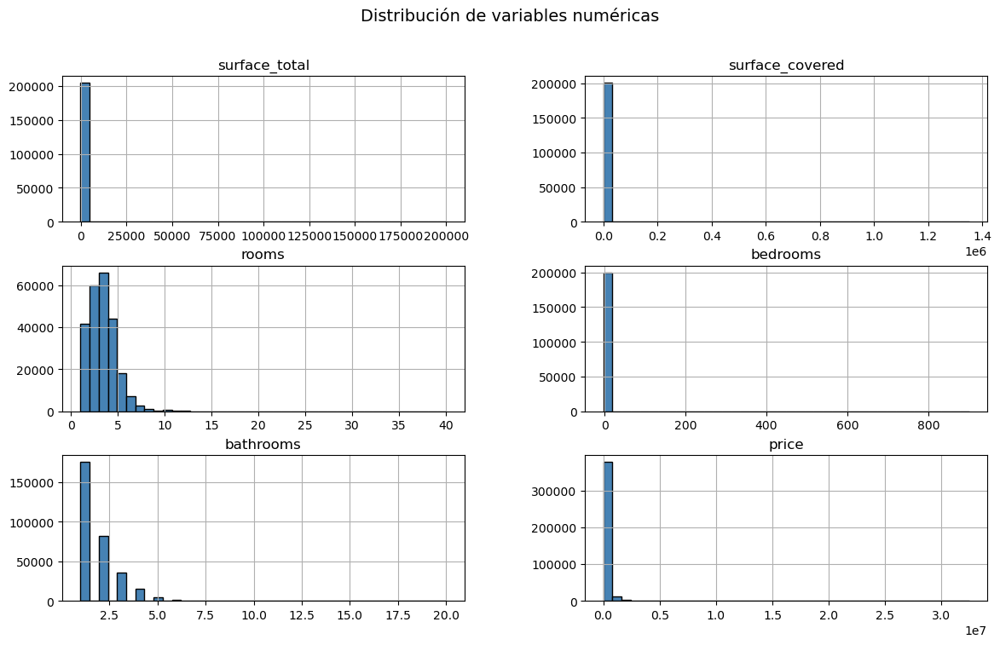

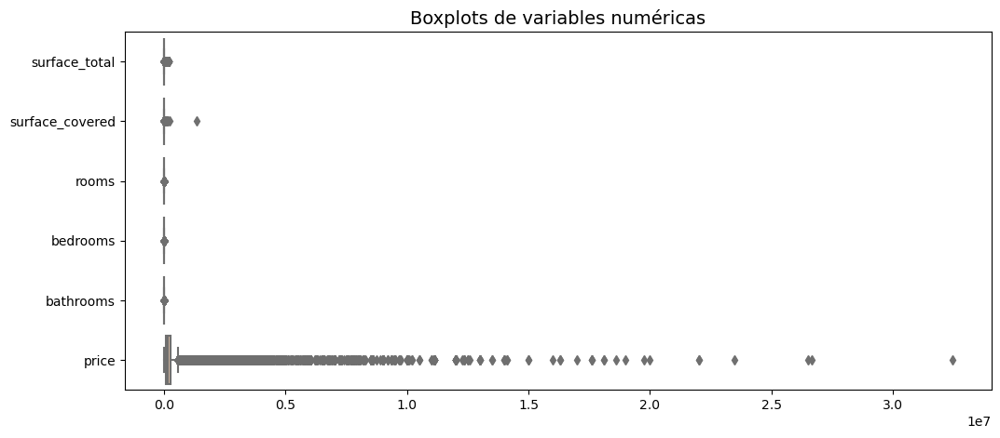

In [10]:
# ------------------------------------------
# 2. Distribuciones de variables numéricas
# ------------------------------------------
num_vars = ['surface_total', 'surface_covered', 'rooms', 'bedrooms', 'bathrooms', 'price']

df_filtered[num_vars].hist(bins=40, figsize=(14,8), color='steelblue', edgecolor='black')
plt.suptitle('Distribución de variables numéricas', fontsize=14)
plt.show()

# Boxplots para detectar outliers
plt.figure(figsize=(12,5))
sns.boxplot(data=df_filtered[num_vars], orient="h", palette="pastel")
plt.title("Boxplots de variables numéricas", fontsize=14)
plt.show()


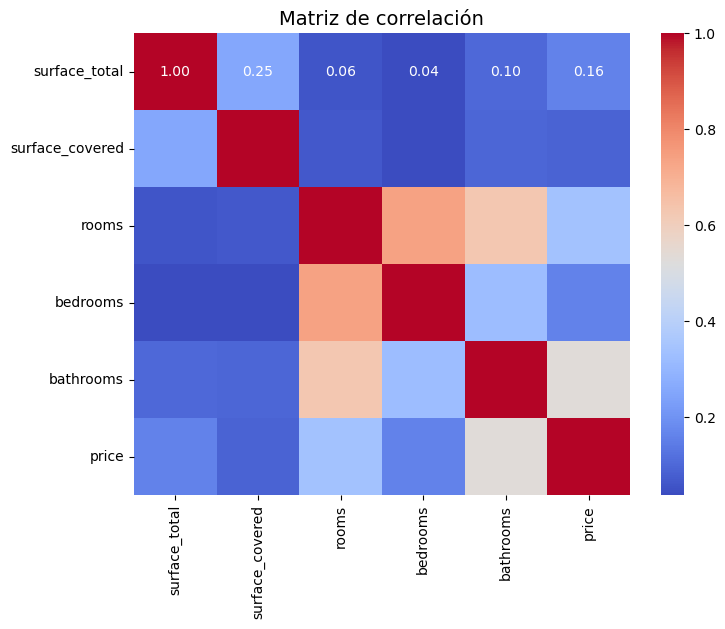


Correlaciones con el precio:
price              1.000000
bathrooms          0.530059
rooms              0.340283
bedrooms           0.160919
surface_total      0.159211
surface_covered    0.086717
Name: price, dtype: float64


In [11]:
# ------------------------------------------
# 3. Correlaciones con el precio
# ------------------------------------------
corr_matrix = df_filtered[num_vars].corr(numeric_only=True)
plt.figure(figsize=(8,6))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', fmt=".2f")
plt.title("Matriz de correlación", fontsize=14)
plt.show()

print("\nCorrelaciones con el precio:")
print(corr_matrix['price'].sort_values(ascending=False))

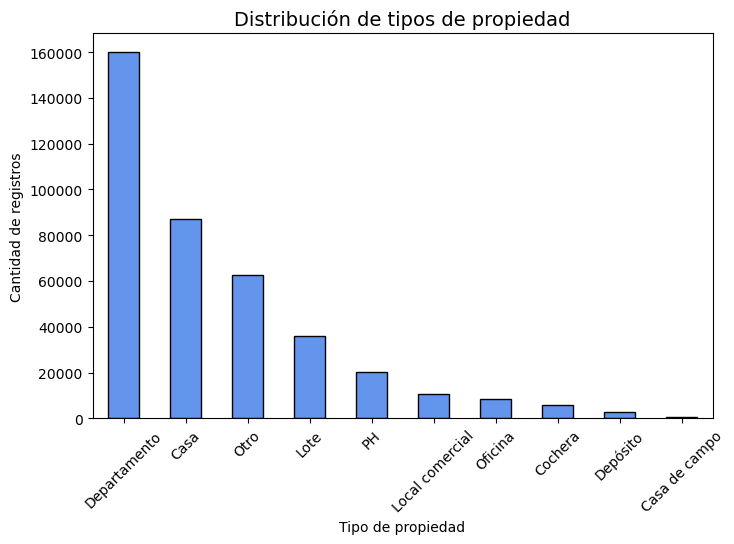

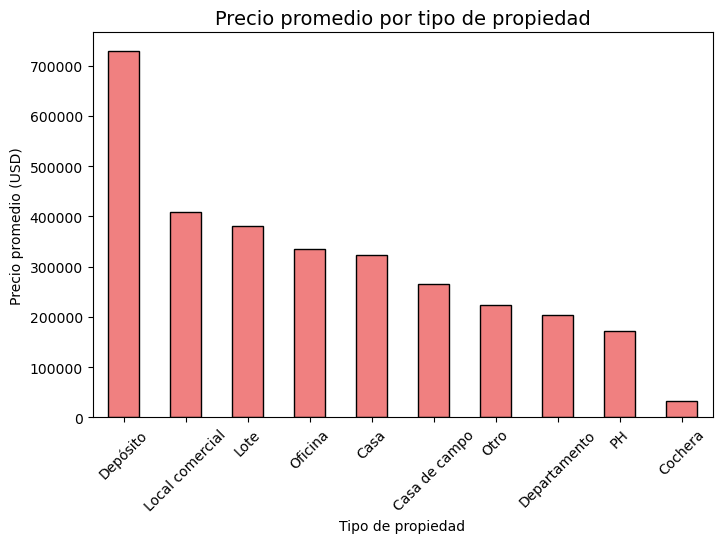

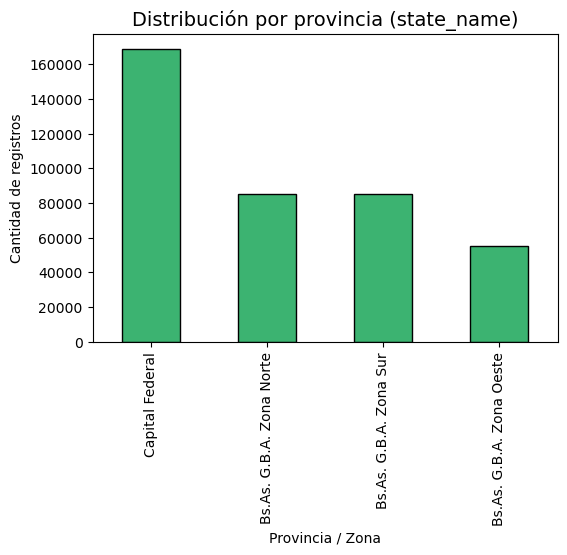

In [12]:
# ------------------------------------------
# 4. Análisis de variables categóricas
# ------------------------------------------
# a) Tipos de propiedad
plt.figure(figsize=(8,5))
df_filtered['property_type'].value_counts().plot(kind='bar', color='cornflowerblue', edgecolor='black')
plt.title("Distribución de tipos de propiedad", fontsize=14)
plt.xlabel("Tipo de propiedad")
plt.ylabel("Cantidad de registros")
plt.xticks(rotation=45)
plt.show()

# Precio promedio por tipo de propiedad
plt.figure(figsize=(8,5))
df_filtered.groupby('property_type')['price'].mean().sort_values(ascending=False).plot(kind='bar', color='lightcoral', edgecolor='black')
plt.title("Precio promedio por tipo de propiedad", fontsize=14)
plt.ylabel("Precio promedio (USD)")
plt.xlabel("Tipo de propiedad")
plt.xticks(rotation=45)
plt.show()

# b) Estado o región (CABA / GBA)
plt.figure(figsize=(6,4))
df_filtered['l2'].value_counts().plot(kind='bar', color='mediumseagreen', edgecolor='black')
plt.title("Distribución por provincia (state_name)", fontsize=14)
plt.xlabel("Provincia / Zona")
plt.ylabel("Cantidad de registros")
plt.show()

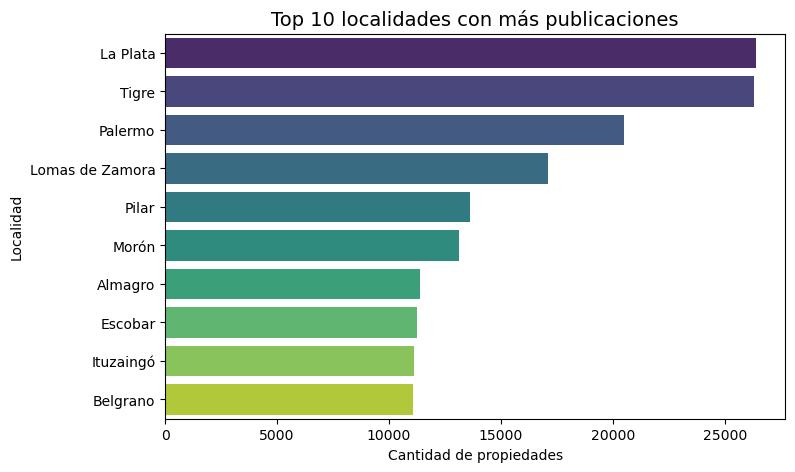

In [13]:
# ------------------------------------------
# 5. Localidades más frecuentes
# ------------------------------------------
top_places = df_filtered['l3'].value_counts().head(10)
plt.figure(figsize=(8,5))
sns.barplot(x=top_places.values, y=top_places.index, palette="viridis")
plt.title("Top 10 localidades con más publicaciones", fontsize=14)
plt.xlabel("Cantidad de propiedades")
plt.ylabel("Localidad")
plt.show()

# ------------------------------------------
# 6. Exploración geográfica
# ------------------------------------------

fig = px.scatter_mapbox(
    df_filtered, lat="lat", lon="lon", color="price",
    mapbox_style="carto-positron", zoom=9, height=500,
    title="Mapa interactivo de propiedades según precio (USD)"
)
fig.show()


# 4. Limpieza de datos

In [14]:
""" Eliminar duplicados: se eliminan filas que pueden estar repetidas que ocupan espacio innecesario"""
df_clean = df_filtered.drop_duplicates()

""" Eliminar variables con excesivo nulos y son irrelevantes para el análisis"""
cols_to_drop = ['l4', 'l5', 'l6', 'price_period']
df_clean = df_clean.drop(columns=cols_to_drop)

"""  Ahora elimino filas con  nulos de columnas importante"""
df_clean = df_clean.dropna(subset=['lat', 'lon', 'price'])

In [15]:
""" Tratamiento de ouliers en precio: Eliminamos el 1% de los precios más altos y el 1% de los precios más bajos, estos son propoiedades muy atipicas
además también se podría ver como un balance entre conservar los datos y eliminar el ruido """
q1_price = df_clean['price'].quantile(0.01)
q99_price = df_clean['price'].quantile(0.99)
df_clean = df_clean[(df_clean['price'] >= q1_price) & 
                    (df_clean['price'] <= q99_price)]

In [16]:
""" Crear una variable variable unica para superficie combinando surface_total y surface_covered en una sola variable
Esto también es por que algunos tienen surface_total nulo y surface_covered con valores """
df_clean['superficie'] = df_clean['surface_total'].fillna(df_clean['surface_covered'])

"""Filtrar por superficie razonable se establece entre 20 y 5000  m² """
df_clean = df_clean[(df_clean['superficie'] >= 20) & (df_clean['superficie'] <= 1000)]

In [17]:
"""Imputación de valores faltantes de las variables numéricas con la mediana estas variables son: rooms, bedrooms, bathrooms y son importantes para el modelo"""
cols_to_impute = ['rooms', 'bedrooms', 'bathrooms']
for col in cols_to_impute:
    df_clean[col] = df_clean[col].fillna(df_clean[col].median())


"""Imputación de valores faltantes de la variable l3 con la cadena 'Desconocido' esta variable es importante para el modelo"""
df_clean['l3'] = df_clean['l3'].fillna('Desconocido')

Selección de variables y su debida justificación 
1. price: Variable objetivo
2. superficie: Principal determinante del precio (más m² = mayor precio)
3. rooms/bedrooms/bathrooms: Características que definen funcionalidad
4. property_type: Casas vs departamentos tienen precios muy diferentes
5. Ubicación (place_name, state_name, lat, lon):
* El precio varía enormemente por barrio
* Las coordenadas permiten calcular distancias a puntos de interés
* Es el factor "location, location, location" del mercado inmobiliario

In [18]:
# Renombrar columnas para mayor claridad
df_clean = df_clean.rename(columns={
    'l3': 'place_name',
    'l2': 'state_name'
})
# Seleccionar variables relevantes
cols_modelo = [
    'price',
    'superficie',
    'rooms',
    'bedrooms',
    'bathrooms',
    'property_type',
    'state_name',
    'place_name',
    'lat',
    'lon'
]

df_modelo = df_clean[cols_modelo].copy()

In [19]:
from funpymodeling.exploratory import status
status(df_modelo)


,variable,q_nan,p_nan,q_zeros,p_zeros,unique,type
0,price,0,0.0,0,0.000000,7083,float64
1,superficie,0,0.0,0,0.000000,981,float64
2,rooms,0,0.0,0,0.000000,31,float64
3,bedrooms,0,0.0,32,0.000175,30,float64
4,bathrooms,0,0.0,0,0.000000,17,float64
5,property_type,0,0.0,0,0.000000,10,object
6,state_name,0,0.0,0,0.000000,4,object
7,place_name,0,0.0,0,0.000000,91,object
8,lat,0,0.0,0,0.000000,86020,float64
9,lon,0,0.0,0,0.000000,85404,float64


# 5. Guardar el dataset limpio final

In [20]:
# Crear carpeta 
import os
os.makedirs('data', exist_ok=True)

# Guardar dataset limpio
output_path = '../01_EDA/data/processed.csv'
df_modelo.to_csv(output_path, index=False)
print(f"\n✅ Dataset procesado guardado exitosamente en: {output_path}")
print(f"  - Registros: {len(df_modelo):,}")
print(f"  - Variables: {len(df_modelo.columns)}")



✅ Dataset procesado guardado exitosamente en: ../01_EDA/data/processed.csv
  - Registros: 183,063
  - Variables: 10


# 6. Conclusiones del negocio:

El análisis muestra que el mercado inmobiliario argentino está fuertemente concentrado en operaciones en dólares, lo que indica que los anuncios corresponden principalmente al segmento medio y alto del mercado. La mayor actividad se encuentra en la Capital Federal y el Gran Buenos Aires, zonas que concentran la mayoría de las publicaciones y reflejan el núcleo del mercado más dinámico del país.

Luego de limpiar los datos y eliminar valores atípicos, los precios se concentran en un rango típico de propiedades residenciales, lo que permite representar mejor el comportamiento real del mercado. Se observó una correlación positiva entre el precio y la superficie, confirmando que el tamaño del inmueble es uno de los factores determinantes del valor de venta. En cuanto a los tipos de propiedad, los departamentos predominan en CABA, mientras que las casas son más comunes en el GBA, lo que refleja diferentes perfiles de vivienda y de demanda según la zona.

El modelo que se construya a partir de estos datos estará enfocado en el mercado de CABA y GBA, y orientado a predecir precios en dólares de propiedades de tipo residencial. Funcionará de manera más confiable en rangos de superficie entre 20 y 1.000 m², donde se concentra la mayoría de las observaciones. Las variables más importantes para el modelo serán la superficie, la ubicación (state_name, place_name, lat, lon), rooms, bedrooms, bathrooms y el tipo de propiedad.

Entre las limitaciones del análisis se encuentran la exclusión de propiedades publicadas en pesos y de las operaciones de alquiler, por lo que el modelo no es representativo del segmento económico ni del mercado de renta. Además, el alcance geográfico está restringido a CABA y GBA, por lo que no puede generalizarse a otras provincias.

En síntesis, el estudio permite entender el comportamiento del mercado inmobiliario metropolitano argentino, donde la ubicación y la superficie son los principales determinantes del precio.
